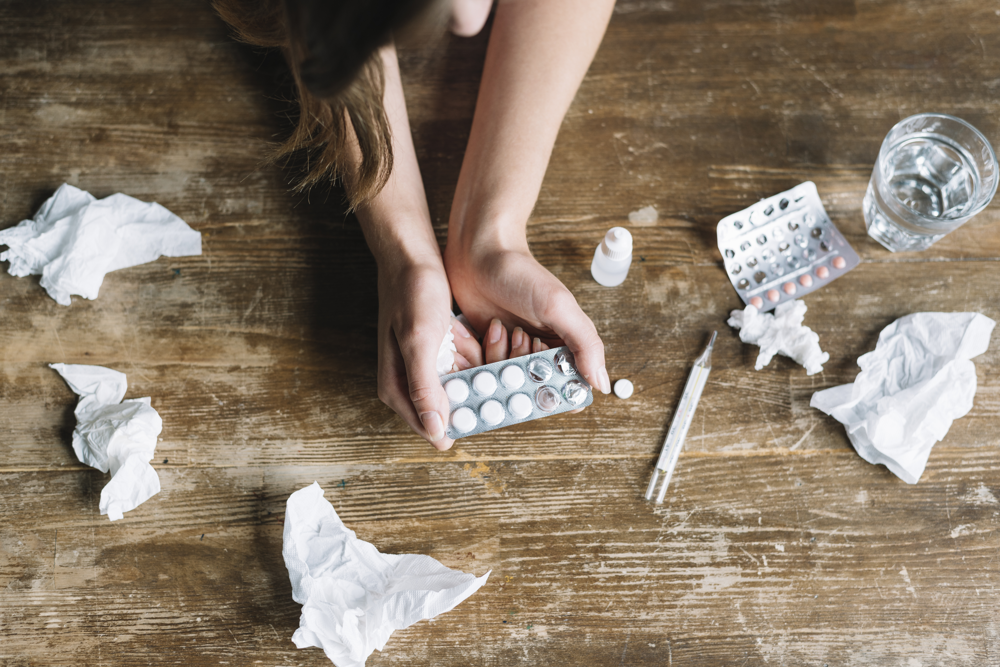

In [1]:
#Importing Neccessary Liabaries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
df = pd.read_csv(r"D:\ICTAK\DSA\rio 125\Side Effects of drug\Dataset\DRUG  SIDE EFFECTS.csv")

In [3]:
# Display the first few rows
print("First Few Rows:")
print(df.head())

First Few Rows:
                Name   Age  Gender      Race                   Side Effects
0     Justin Hopkins  41.0  female  Hispanic              Mild Side Effects
1     Heather Murphy  53.0    male     Asian  Extremely Severe Side Effects
2      Michael Burns  31.0  female     White              Mild Side Effects
3        Amy Elliott  44.0  female     White            Severe Side Effects
4  Alexander Johnson  24.0    male     Black                No Side Effects


In [4]:
# Display the Last few rows
print("Last Few Rows:")
print(df.tail())

Last Few Rows:
                    Name   Age  Gender      Race         Side Effects
399995  Kayla Guzman DDS  50.0  female     Black  Severe Side Effects
399996     Timothy Potts  55.0  female  Hispanic      No Side Effects
399997      Maria Steele  57.0  female     Asian  Severe Side Effects
399998        Jacob Best  59.0  female     White      No Side Effects
399999  Carmen Hernandez  65.0  female     Black    Mild Side Effects


In [5]:
# Display DataFrame information
print("\nDataFrame Information:")
df.info()


DataFrame Information:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 400000 entries, 0 to 399999
Data columns (total 5 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   Name          400000 non-null  object 
 1   Age           399980 non-null  float64
 2   Gender        400000 non-null  object 
 3   Race          400000 non-null  object 
 4   Side Effects  400000 non-null  object 
dtypes: float64(1), object(4)
memory usage: 15.3+ MB


In [6]:
# Get DataFrame shape
print("\nDataFrame Shape:")
print(df.shape)


DataFrame Shape:
(400000, 5)


In [7]:
# Get summary statistics for all columns
summary_stats = df.describe(include='all')

In [8]:

summary_stats.T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
Name,400000,192090,Michael Smith,205,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Age,399980.0,NaN,NaN,NaN,41.466513,12.550773,14.0,31.0,41.0,51.0,600.0
Gender,400000,2,female,279717,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Race,400000,4,White,128541,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Side Effects,400000,5,Mild Side Effects,133236,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Missing Value Check

In [9]:
df.isna().sum()

Name             0
Age             20
Gender           0
Race             0
Side Effects     0
dtype: int64

In [10]:
#filling the missing values in age with respect to the median of it.
df["Age"]=df["Age"].fillna(df["Age"].median())
df.isna().sum()

Name            0
Age             0
Gender          0
Race            0
Side Effects    0
dtype: int64

### outlier Handling

In [11]:
# Calculate quartile values for 'AGE' using 30,60 and 90 percentile values
Q1=np.percentile(df["Age"],30,interpolation= "midpoint")
Q2=np.percentile(df["Age"],60,interpolation= "midpoint")
Q3=np.percentile(df["Age"],90,interpolation= "midpoint")
print("value of Q1:",Q1)
print("value of Q2:",Q2)
print("value of Q3:",Q3)

value of Q1: 34.0
value of Q2: 45.0
value of Q3: 57.0


In [12]:
df["Age"].median()

41.0

In [13]:
IQR= Q3-Q1

In [14]:
Upper_lim= Q3+1.5*IQR
Lower_lim=Q1-1.5*IQR
print("Upper limit value is:",Upper_lim)
print("Lower limit value is:",Lower_lim)

Upper limit value is: 91.5
Lower limit value is: -0.5


In [15]:
outlier=[]
for x in df["Age"]:
    if((x>Upper_lim)or(x<Lower_lim)):
        outlier.append(x)

In [16]:
outlier

[300.0,
 302.0,
 500.0,
 400.0,
 203.0,
 160.0,
 400.0,
 191.0,
 450.0,
 390.0,
 155.0,
 300.0,
 390.0,
 600.0,
 211.0,
 600.0,
 401.0,
 300.0,
 390.0]

In [17]:
ind_val=df["Age"]>Upper_lim
df.loc[ind_val].index

Int64Index([  3008,  41048,  66169,  85047, 111850, 119574, 127240, 171643,
            174039, 174487, 224733, 232518, 264849, 290165, 325631, 333669,
            337790, 384352, 393820],
           dtype='int64')

In [18]:
df.drop([ 3008,  41048,  66169,  85047, 111850, 119574, 127240, 171643,
            174039, 174487, 224733, 232518, 264849, 290165, 325631, 333669,
            337790, 384352, 393820],inplace=True)


In [19]:
df["Age"].describe()

count    399981.000000
mean         41.451851
std          12.337345
min          14.000000
25%          31.000000
50%          41.000000
75%          51.000000
max          90.000000
Name: Age, dtype: float64

### EDA

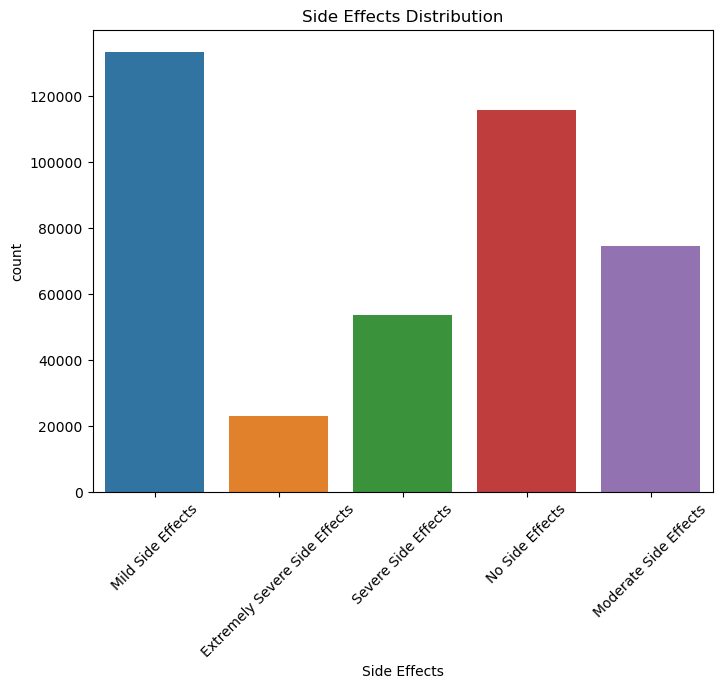

In [20]:
# Side effects distribution
plt.figure(figsize=(8, 6))
sns.countplot(data=df, x='Side Effects')
plt.title('Side Effects Distribution')
plt.xticks(rotation=45)
plt.show()

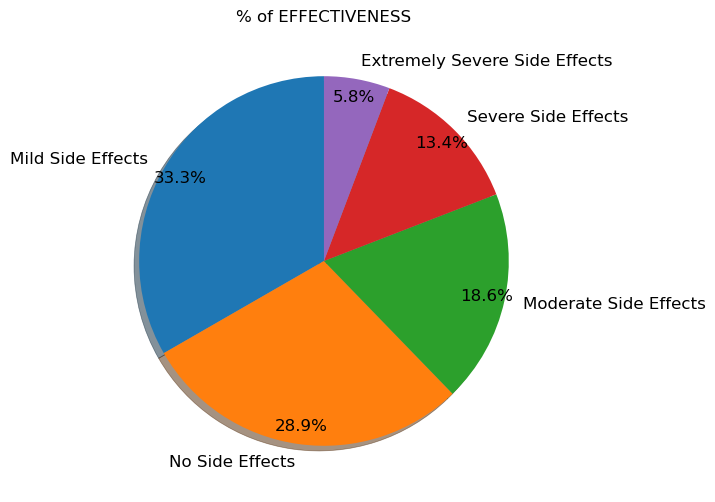

In [21]:
plt.figure(figsize=(10,6))
plt.title('% of EFFECTIVENESS')
tr = pd.DataFrame(df['Side Effects'].value_counts())
tr_names = tr.index
count = tr['Side Effects']
plt.style.use('ggplot')
plt.rc('font', size=12)
plt.pie(count, autopct='%1.1f%%', labels = tr_names, pctdistance=0.9, labeldistance=1.1,shadow=True, startangle=90)

plt.show()

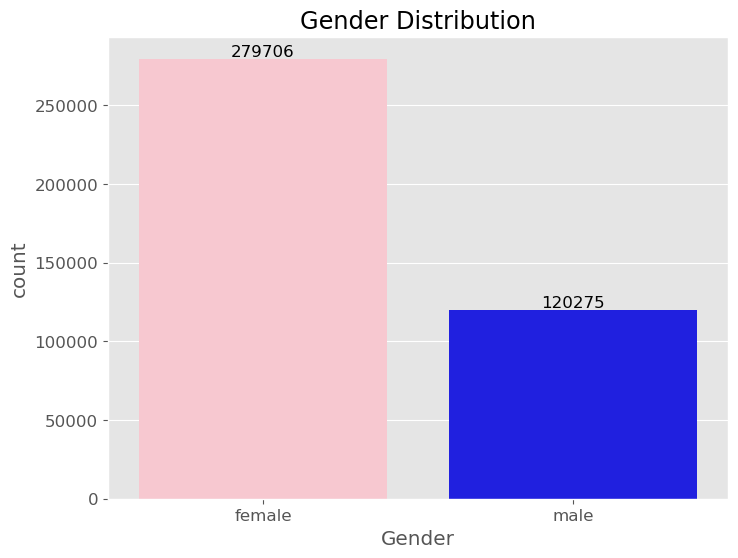

In [22]:
# Map genders to colors
gender_colors = {'male': 'blue', 'female': 'pink'}

# Gender distribution
plt.figure(figsize=(8, 6))
ax = sns.countplot(data=df, x='Gender', palette=gender_colors)
plt.title('Gender Distribution')

# Add count annotations on top of the bars
for p in ax.patches:
    ax.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=12, color='black', xytext=(0, 5),
                textcoords='offset points')

plt.show()

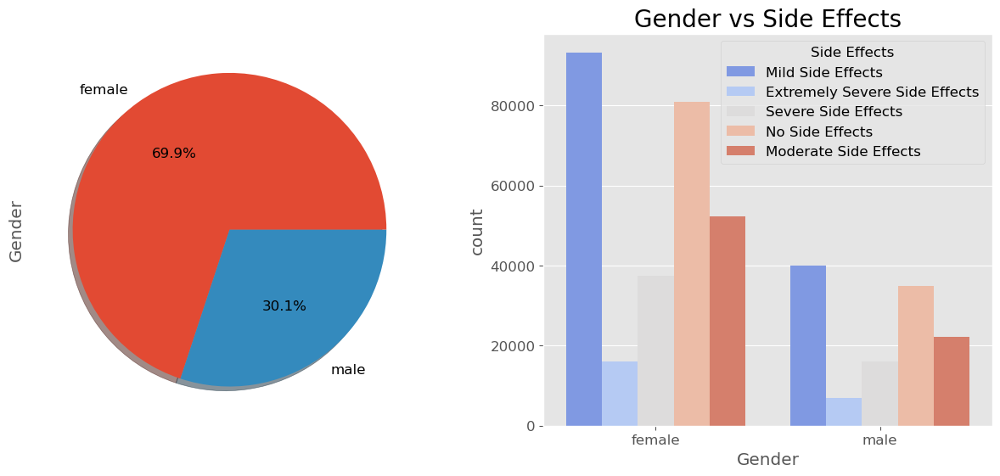

female    0.699298
male      0.300702
Name: Gender, dtype: float64

In [23]:
plt.figure(figsize=(15,6))
plt.subplot(1, 2, 1)
df['Gender'].value_counts().plot.pie(autopct='%1.1f%%',shadow=True)
plt.subplot(1, 2, 2)
sns.countplot(data = df, x = 'Gender',hue='Side Effects' ,palette='coolwarm')
plt.title('Gender vs Side Effects', size=20)
plt.show()
df.Gender.value_counts(normalize=True)

In [24]:

from scipy.stats import chi2_contingency

# Create a contingency table of gender vs side effects
contingency_table = pd.crosstab(df['Gender'], df['Side Effects'])

# Perform the chi-squared test for independence
chi2, p, _, _ = chi2_contingency(contingency_table)

# Define a significance level (e.g., 0.05)
alpha = 0.05

# Check if the p-value is less than the significance level
if p < alpha:
    print("There is a statistically significant association between gender and side effects.")
else:
    print("There is no statistically significant association between gender and side effects.")


There is no statistically significant association between gender and side effects.


In [25]:
df["Race"].unique()

array(['Hispanic', 'Asian', 'White', 'Black'], dtype=object)

In [26]:
#Checking value counts of "RACE"
df["Race"].value_counts()

White       128531
Hispanic    111817
Black        87406
Asian        72227
Name: Race, dtype: int64

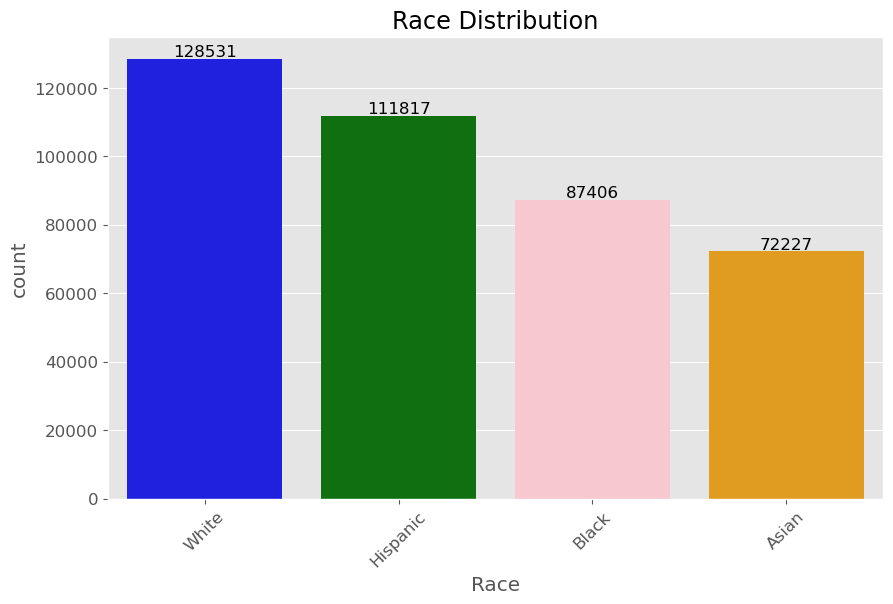

In [27]:
# Map races to colors (if desired)
race_colors = {'White': 'blue', 'Black': 'pink', 'Hispanic': 'green', 'Asian': 'orange', 'Other': 'purple'}

# Race distribution
plt.figure(figsize=(10, 6))
ax = sns.countplot(data=df, x='Race', palette=race_colors, order=df['Race'].value_counts().index)
plt.title('Race Distribution')
plt.xticks(rotation=45)

# Add count annotations on top of the bars
for p in ax.patches:
    ax.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=12, color='black', xytext=(0, 5),
                textcoords='offset points')

plt.show()

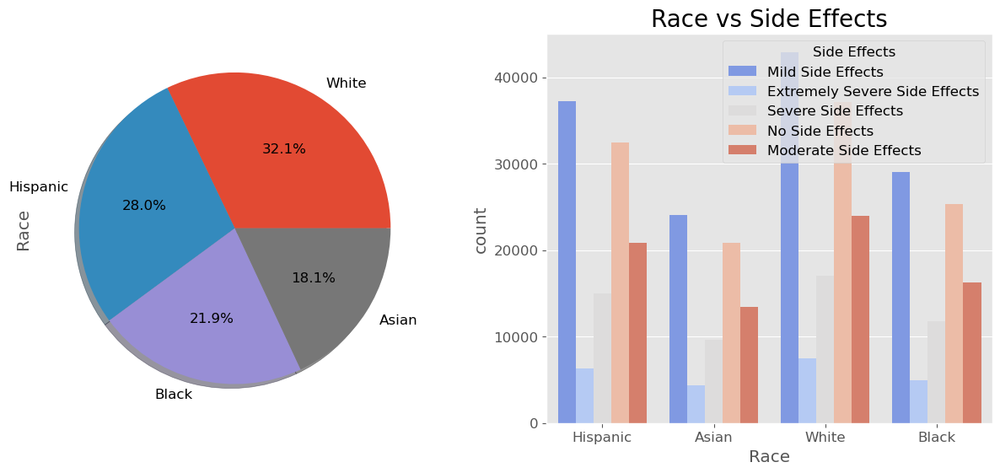

White       0.321343
Hispanic    0.279556
Black       0.218525
Asian       0.180576
Name: Race, dtype: float64

In [28]:

plt.figure(figsize=(15,6))
plt.subplot(1, 2, 1)
df['Race'].value_counts().plot.pie(autopct='%1.1f%%',shadow=True)
plt.subplot(1, 2, 2)
sns.countplot(data = df, x = 'Race',hue='Side Effects' ,palette='coolwarm')
plt.title('Race vs Side Effects', size=20)
plt.show()
df.Race.value_counts(normalize=True)

In [29]:

from scipy.stats import chi2_contingency

# Create a contingency table of race vs side effects
contingency_table = pd.crosstab(df['Race'], df['Side Effects'])

# Perform the chi-squared test for independence
chi2, p, _, _ = chi2_contingency(contingency_table)

# Define a significance level (e.g., 0.05)
alpha = 0.05

# Check if the p-value is less than the significance level
if p < alpha:
    print("There is a statistically significant association between race and side effects.")
else:
    print("There is no statistically significant association between race and side effects.")


There is no statistically significant association between race and side effects.


In [30]:
# Group the data by 'Race' and 'Side Effects' and count the occurrences
race_side_effects_counts = df.groupby(['Race', 'Side Effects']).size().reset_index(name='Count')

# Find the race with the most side effects
race_with_most_side_effects = race_side_effects_counts.groupby('Race')['Count'].sum().idxmax()
count_of_most_side_effects = race_side_effects_counts.groupby('Race')['Count'].sum().max()

# Filter the data for the race with the most side effects
most_side_effects_data = race_side_effects_counts[race_side_effects_counts['Race'] == race_with_most_side_effects]

print("Race with the most side effects:", race_with_most_side_effects)
print("Number of side effects for that race:", count_of_most_side_effects)
print("Side effects for that race:")
print(most_side_effects_data)



Race with the most side effects: White
Number of side effects for that race: 128531
Side effects for that race:
     Race                   Side Effects  Count
15  White  Extremely Severe Side Effects   7456
16  White              Mild Side Effects  42913
17  White          Moderate Side Effects  23948
18  White                No Side Effects  37163
19  White            Severe Side Effects  17051


In [31]:
# Group the data by 'Race' and 'Side Effects' and count the occurrences
race_side_effects_counts = df.groupby(['Race', 'Side Effects']).size().reset_index(name='Count')

# Find the race with the least side effects
race_with_least_side_effects = race_side_effects_counts.groupby('Race')['Count'].sum().idxmin()
count_of_least_side_effects = race_side_effects_counts.groupby('Race')['Count'].sum().min()

# Filter the data for the race with the least side effects
least_side_effects_data = race_side_effects_counts[race_side_effects_counts['Race'] == race_with_least_side_effects]

print("Race with the least side effects:", race_with_least_side_effects)
print("Number of side effects for that race:", count_of_least_side_effects)
print("Side effects for that race:")
print(least_side_effects_data)


Race with the least side effects: Asian
Number of side effects for that race: 72227
Side effects for that race:
    Race                   Side Effects  Count
0  Asian  Extremely Severe Side Effects   4319
1  Asian              Mild Side Effects  24067
2  Asian          Moderate Side Effects  13390
3  Asian                No Side Effects  20842
4  Asian            Severe Side Effects   9609


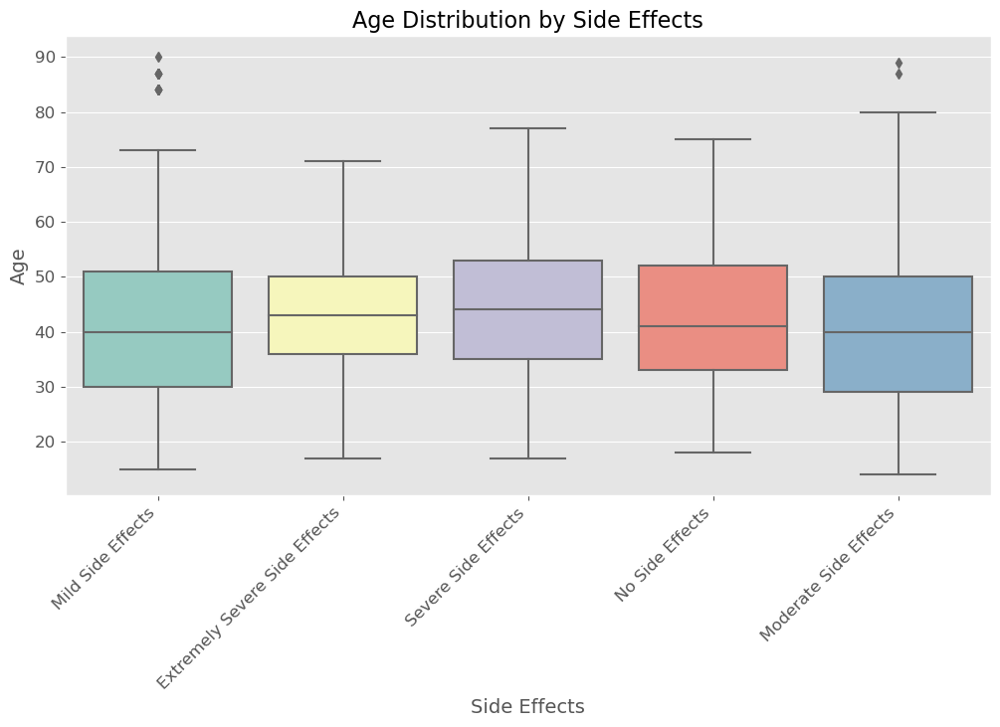

In [32]:
# Create a boxplot to visualize age distribution for each side effect
plt.figure(figsize=(12, 6))
sns.boxplot(data=df, x='Side Effects', y='Age', palette='Set3')
plt.title('Age Distribution by Side Effects', size=16)
plt.xticks(rotation=45, horizontalalignment='right')
plt.xlabel('Side Effects', size=14)
plt.ylabel('Age', size=14)
plt.show()

In [33]:
from scipy.stats import kruskal

# Create separate dataframes for each side effect
side_effect_groups = [group['Age'] for _, group in df.groupby('Side Effects')]

# Perform Kruskal-Wallis test
stat, p_value = kruskal(*side_effect_groups)

if p_value < 0.05:
    print("There is a statistically significant difference in age distributions across different side effects.")
else:
    print("There is no statistically significant difference in age distributions across different side effects.")


There is a statistically significant difference in age distributions across different side effects.


In [34]:
# Group the data by age and side effects, and count the occurrences
age_side_effect_counts = df.groupby(['Age', 'Side Effects']).size().unstack(fill_value=0)

# Find the age group with the highest total side effects
age_group_most_side_effects = age_side_effect_counts.sum(axis=1).idxmax()

# Get the specific side effects for the age group with the most side effects
most_side_effects_for_age_group = age_side_effect_counts.loc[age_group_most_side_effects]

print("Age group with the most side effects:", age_group_most_side_effects)
print("Side effects for that age group:")
print(most_side_effects_for_age_group)

Age group with the most side effects: 55.0
Side effects for that age group:
Side Effects
Extremely Severe Side Effects    1076
Mild Side Effects                4863
Moderate Side Effects            1996
No Side Effects                  5568
Severe Side Effects              2069
Name: 55.0, dtype: int64


In [35]:
# Group the data by age and side effects, and count the occurrences
age_side_effect_counts = df.groupby(['Age', 'Side Effects']).size().unstack(fill_value=0)

# Find the age group with the lowest total side effects
age_group_least_side_effects = age_side_effect_counts.sum(axis=1).idxmin()

# Get the specific side effects for the age group with the least side effects
least_side_effects_for_age_group = age_side_effect_counts.loc[age_group_least_side_effects]

print("Age group with the least side effects:", age_group_least_side_effects)
print("Side effects for that age group:")
print(least_side_effects_for_age_group)

Age group with the least side effects: 77.0
Side effects for that age group:
Side Effects
Extremely Severe Side Effects    0
Mild Side Effects                0
Moderate Side Effects            0
No Side Effects                  0
Severe Side Effects              1
Name: 77.0, dtype: int64


In [36]:


# Filter the dataset for rows with severe side effects
severe_side_effects_df = df[df['Side Effects'] == 'Severe Side Effects']

# Group the filtered data by age and count the occurrences
age_severe_side_effect_counts = severe_side_effects_df['Age'].value_counts()

# Find the age group with the most severe side effects
age_with_most_severe_side_effects = age_severe_side_effect_counts.idxmax()
count_of_most_severe_side_effects = age_severe_side_effect_counts.max()

print("Age group with the most severe side effects:", age_with_most_severe_side_effects)
print("Number of severe side effects in that age group:", count_of_most_severe_side_effects)


Age group with the most severe side effects: 44.0
Number of severe side effects in that age group: 4007


In [37]:


# Filter the dataset for rows with no side effects
no_side_effects_df = df[df['Side Effects'] == 'No Side Effects']

# Group the filtered data by age and count the occurrences
age_no_side_effect_counts = no_side_effects_df['Age'].value_counts()

# Find the age group with the most "No Side Effects"
age_with_most_no_side_effects = age_no_side_effect_counts.idxmax()
count_of_most_no_side_effects = age_no_side_effect_counts.max()

print("Age group with the most 'No Side Effects':", age_with_most_no_side_effects)
print("Number of 'No Side Effects' in that age group:", count_of_most_no_side_effects)


Age group with the most 'No Side Effects': 35.0
Number of 'No Side Effects' in that age group: 6126


In [38]:


# Filter the dataset for rows with "Extremely Severe Side Effects"
extremely_severe_side_effects_df = df[df['Side Effects'] == 'Extremely Severe Side Effects']

# Group the filtered data by age and count the occurrences
age_extremely_severe_side_effect_counts = extremely_severe_side_effects_df['Age'].value_counts()

# Find the age group with the most "Extremely Severe Side Effects"
age_with_most_extremely_severe_side_effects = age_extremely_severe_side_effect_counts.idxmax()
count_of_most_extremely_severe_side_effects = age_extremely_severe_side_effect_counts.max()

print("Age group with the most 'Extremely Severe Side Effects':", age_with_most_extremely_severe_side_effects)
print("Number of 'Extremely Severe Side Effects' in that age group:", count_of_most_extremely_severe_side_effects)


Age group with the most 'Extremely Severe Side Effects': 41.0
Number of 'Extremely Severe Side Effects' in that age group: 2006


In [39]:


# Filter the dataset for rows with "Moderate Side Effects"
moderate_side_effects_df = df[df['Side Effects'] == 'Moderate Side Effects']

# Group the filtered data by age and count the occurrences
age_moderate_side_effect_counts = moderate_side_effects_df['Age'].value_counts()

# Find the age group with the most "Moderate Side Effects"
age_with_most_moderate_side_effects = age_moderate_side_effect_counts.idxmax()
count_of_most_moderate_side_effects = age_moderate_side_effect_counts.max()

print("Age group with the most 'Moderate Side Effects':", age_with_most_moderate_side_effects)
print("Number of 'Moderate Side Effects' in that age group:", count_of_most_moderate_side_effects)


Age group with the most 'Moderate Side Effects': 29.0
Number of 'Moderate Side Effects' in that age group: 5019


In [40]:


# Filter the dataset for rows with "Mild Side Effects"
mild_side_effects_df = df[df['Side Effects'] == 'Mild Side Effects']

# Group the filtered data by age and count the occurrences
age_mild_side_effect_counts = mild_side_effects_df['Age'].value_counts()

# Find the age group with the most "Mild Side Effects"
age_with_most_mild_side_effects = age_mild_side_effect_counts.idxmax()
count_of_most_mild_side_effects = age_mild_side_effect_counts.max()

print("Age group with the most 'Mild Side Effects':", age_with_most_mild_side_effects)
print("Number of 'Mild Side Effects' in that age group:", count_of_most_mild_side_effects)


Age group with the most 'Mild Side Effects': 56.0
Number of 'Mild Side Effects' in that age group: 5892


### Encoding

In [41]:
data = df.copy()

In [42]:
data.drop(columns=['Name'], inplace=True)

In [43]:
from sklearn.preprocessing import LabelEncoder

cols = []
for i in data.columns:
    if data[i].dtype == 'object':
        cols.append(i)

labelencoder = LabelEncoder()
mapping =[]
for i in cols:
    data[i] = labelencoder.fit_transform(data[i])
    lemap = dict(zip(labelencoder.classes_,labelencoder.transform(labelencoder.classes_)))
    mapping.append(lemap)

print(f"Mapped labels of the features in data are {mapping}")


Mapped labels of the features in data are [{'female': 0, 'male': 1}, {'Asian': 0, 'Black': 1, 'Hispanic': 2, 'White': 3}, {'Extremely Severe Side Effects': 0, 'Mild Side Effects': 1, 'Moderate Side Effects': 2, 'No Side Effects': 3, 'Severe Side Effects': 4}]


In [44]:
data

,Age,Gender,Race,Side Effects
0,41.0,0,2,1
1,53.0,1,0,0
2,31.0,0,3,1
3,44.0,0,3,4
4,24.0,1,1,3
...,...,...,...,...
399995,50.0,0,1,4
399996,55.0,0,2,3
399997,57.0,0,0,4
399998,59.0,0,3,3
